## Assignment: Advanced Regression

### Assignment<br/>
    - A US-based housing company named Surprise Housing has decided to enter the Australian market
    - The company uses data analytics to purchase houses at a price below their actual values and flip them on at a higher price
    - For the same purpose, the company has collected a data set from the sale of houses in Australia

The company wants to know <br/>
    - Which variables are significant in predicting the price of a house <br/>
    - How well those variables describe the price of a house <br/>
   
Also, determine the optimal value of lambda for ridge and lasso regression <br/>

### Business Goal 

    - Model the price of houses with the available independent variables
    - This model will beused by the management to understand how exactly the prices vary with the variables

## Data Exploration

In [8511]:
#importing libraries for Data Exploration & Visualisation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#suppress the warnings
import warnings
warnings.filterwarnings('ignore')

In [8512]:
#importing data file
housing = pd.read_csv('train.csv')

#returns the first five rows in the Dataframe
housing.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [8513]:
#checking the number of observation & columns

housing.shape

(1460, 81)

**There are totally 1460 rows & 81 columns in the `housing` Dataframe**

In [8514]:
#function to find the number of missing values in each column

def missingValues():
    print(housing.isnull().sum())
    
missingValues()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       259
LotArea             0
Street              0
Alley            1369
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          8
MasVnrArea          8
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           37
BsmtCond           37
BsmtExposure       38
BsmtFinType1       37
BsmtFinSF1          0
BsmtFinType2       38
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          1
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [8515]:
#function to find the percentage of missing values in each column

def missingPercentage():
    print(round(100*(housing.isnull().sum() / housing.shape[0]), 2))
    
missingPercentage()

Id                0.00
MSSubClass        0.00
MSZoning          0.00
LotFrontage      17.74
LotArea           0.00
Street            0.00
Alley            93.77
LotShape          0.00
LandContour       0.00
Utilities         0.00
LotConfig         0.00
LandSlope         0.00
Neighborhood      0.00
Condition1        0.00
Condition2        0.00
BldgType          0.00
HouseStyle        0.00
OverallQual       0.00
OverallCond       0.00
YearBuilt         0.00
YearRemodAdd      0.00
RoofStyle         0.00
RoofMatl          0.00
Exterior1st       0.00
Exterior2nd       0.00
MasVnrType        0.55
MasVnrArea        0.55
ExterQual         0.00
ExterCond         0.00
Foundation        0.00
BsmtQual          2.53
BsmtCond          2.53
BsmtExposure      2.60
BsmtFinType1      2.53
BsmtFinSF1        0.00
BsmtFinType2      2.60
BsmtFinSF2        0.00
BsmtUnfSF         0.00
TotalBsmtSF       0.00
Heating           0.00
HeatingQC         0.00
CentralAir        0.00
Electrical        0.07
1stFlrSF   

In [8516]:
#missing values & percentage rows information are shrunk
# So we use display.max_rows to view all the columngs
 
pd.set_option('display.max_rows', housing.shape[0])

## Data Cleaning

### Alley: Type of alley access to property

In [8517]:
#Alley has 93.77% missing values
#check the value counts of categories in Alley

housing['Alley'].value_counts()

Grvl    50
Pave    41
Name: Alley, dtype: int64

**In the Dictionary, it's mentioned that missing values(NA) in Alley means 'No alley access'**

Alley: Type of alley access to property

       Grvl	Gravel
       Pave	Paved
       NA 	No alley access

**So, we can impute the missing values in Alley with** `no`

In [8518]:
#imputing missing value in Alley with 'no'

housing['Alley'].fillna('no', inplace=True)

In [8519]:
#check the value counts of categories in Alley

housing['Alley'].value_counts()

no      1369
Grvl      50
Pave      41
Name: Alley, dtype: int64

### MasVnrType: Masonry veneer type
### MasVnrArea: Masonry veneer area in square feet

In [8520]:
# 'MasVnrType' & 'MasVnrArea' has 0.55% missing values
#check the value counts of categories in 'MasVnrType'

housing['MasVnrType'].value_counts()

None       864
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64

In [8521]:
# check 'MasVnrType' & 'MasVnrArea' column with null values

pd.set_option('display.max_columns', housing.shape[1])

housing[housing['MasVnrType'].isnull() & (housing['MasVnrArea'].isnull())]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
234,235,60,RL,NaN,7851,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,2002,2002,Gable,CompShg,VinylSd,VinylSd,NaN,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,625,Unf,0,235,860,GasA,Ex,Y,SBrkr,860,1100,0,1960,1,0,2,1,4,1,Gd,8,Typ,2,TA,BuiltIn,2002.0,Fin,2,440,TA,TA,Y,288,48,0,0,0,0,NaN,NaN,NaN,0,5,2010,WD,Normal,216500
529,530,20,RL,NaN,32668,Pave,no,IR1,Lvl,AllPub,CulDSac,Gtl,Crawfor,Norm,Norm,1Fam,1Story,6,3,1957,1975,Hip,CompShg,Wd Sdng,Stone,NaN,NaN,Gd,TA,PConc,TA,TA,No,Rec,1219,Unf,0,816,2035,GasA,TA,Y,SBrkr,2515,0,0,2515,1,0,3,0,4,2,TA,9,Maj1,2,TA,Attchd,1975.0,RFn,2,484,TA,TA,Y,0,0,200,0,0,0,NaN,NaN,NaN,0,3,2007,WD,Alloca,200624
650,651,60,FV,65.0,8125,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,2Story,7,6,2007,2007,Gable,CompShg,CemntBd,CmentBd,NaN,NaN,Gd,TA,PConc,Gd,TA,No,Unf,0,Unf,0,813,813,GasA,Ex,Y,SBrkr,822,843,0,1665,0,0,2,1,3,1,Gd,7,Typ,0,NaN,Attchd,2007.0,RFn,2,562,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,5,2008,WD,Normal,205950
936,937,20,RL,67.0,10083,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,NaN,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,833,Unf,0,343,1176,GasA,Ex,Y,SBrkr,1200,0,0,1200,1,0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,2003.0,RFn,2,555,TA,TA,Y,0,41,0,0,0,0,NaN,NaN,NaN,0,8,2009,WD,Normal,184900
973,974,20,FV,95.0,11639,Pave,no,Reg,Lvl,AllPub,Corner,Gtl,Somerst,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,CemntBd,CmentBd,NaN,NaN,Gd,TA,PConc,Gd,TA,No,Unf,0,Unf,0,1428,1428,GasA,Ex,Y,SBrkr,1428,0,0,1428,0,0,2,0,3,1,Gd,6,Typ,0,NaN,Attchd,2007.0,Fin,2,480,TA,TA,Y,0,120,0,0,0,0,NaN,NaN,NaN,0,12,2008,New,Partial,182000
977,978,120,FV,35.0,4274,Pave,Pave,IR1,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,TwnhsE,1Story,7,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,NaN,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,1106,Unf,0,135,1241,GasA,Ex,Y,SBrkr,1241,0,0,1241,1,0,1,1,1,1,Gd,4,Typ,0,NaN,Attchd,2007.0,Fin,2,569,TA,TA,Y,0,116,0,0,0,0,NaN,NaN,NaN,0,11,2007,New,Partial,199900
1243,1244,20,RL,107.0,13891,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,1Fam,1Story,10,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,NaN,NaN,Ex,TA,PConc,Ex,Gd,Gd,GLQ,1386,Unf,0,690,2076,GasA,Ex,Y,SBrkr,2076,0,0,2076,1,0,2,1,2,1,Ex,7,Typ,1,Gd,Attchd,2006.0,Fin,3,850,TA,TA,Y,216,229,0,0,0,0,NaN,NaN,NaN,0,9,2006,New,Partial,465000
1278,1279,60,RL,75.0,9473,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,8,5,2002,2002,Gable,CompShg,VinylSd,VinylSd,NaN,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,804,Unf,0,324,1128,GasA,Ex,Y,SBrkr,1128,903,0,2031,1,0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,2002.0,RFn,2,577,TA,TA,Y,0,211,0,0,0,0,NaN,NaN,NaN,0,3,2008,WD,Normal,237000


In [8522]:
#number of rows with missing values in both 'MasVnrType' & 'MasVnrArea'

print(len(housing[housing['MasVnrType'].isnull() & (housing['MasVnrArea'].isnull())]))

8


In [8523]:
# check 'MasVnrType' column with value as '0'

housing[housing['MasVnrArea'] == 0]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,2,20,RL,80.0,9600,Pave,no,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
3,4,70,RL,60.0,9550,Pave,no,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
5,6,50,RL,85.0,14115,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
8,9,50,RM,51.0,6120,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,no,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,SBrkr,1077,0,0,1077,1,0,1,0,2,2,TA,5,Typ,2,TA,Attchd,1939.0,RFn,1,205,Gd,TA,Y,0,4,0,0,0,0,NaN,NaN,NaN,0,1,2008,WD,Normal,118000
10,11,20,RL,70.0,11200,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,5,1965,1965,Hip,CompShg,HdBoard,HdBoard,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,906,Unf,0,134,1040,GasA,Ex,Y,SBrkr,1040,0,0,1040,1,0,1,0,3,1,TA,5,Typ,0,NaN,Detchd,1965.0,Unf,1,384,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,129500
12,13,20,RL,NaN,12968,Pave,no,IR2,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1962,1962,Hip,CompShg,HdBoard,Plywood,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,737,Unf,0,175,912,GasA,TA,Y,SBrkr,912,0,0,912,1,0,1,0,2,1,TA,4,Typ,0,NaN,Detchd,1962.0,Unf,1,352,TA,TA,Y,140,0,0,0,176,0,NaN,NaN,NaN,0,9,2008,WD,Normal,144000
15,16,45,RM,51.0,6120,Pave,no,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Norm,Norm,1Fam,1.5Unf,7,8,1929,2001,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,832,832,GasA,Ex,Y,FuseA,854,0,0,854,0,0,1,0,2,1,TA,5,Typ,0,NaN,Detchd,1991.0,Unf,2,576,TA,TA,Y,48,112,0,0,0,0,NaN,GdPrv,NaN,0,7,2007,WD,Normal,132000
17,18,90,RL,72.0,10791,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,Duplex,1Story,4,5,1967,1967,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,Y,SBrkr,1296,0,0,1296,0,0,2,0,2,2,TA,6,Typ,0,NaN,CarPort,1967.0,Unf,2,516,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,Shed,500,10,2006,WD,Normal,90000
18,19,20,RL,66.0,13695,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,SawyerW,RRAe,Norm,1Fam,1Story,5,5,2004,2004,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,TA,TA,No,GLQ,646,Unf,0,468,1114,GasA,Ex,Y,SBrkr,1114,0,0,1114,1,0,1,1,3,1,Gd,6

For the column with 'None' as category 'MasVnrType', 'MasVnrArea' is 0.0

In [8524]:
#checking the most frequent category of 'MasVnrType'

housing['MasVnrType'].mode()

0    None
dtype: object

**Most frequent category of'MasVnrType' is 'None'.**
**So we can impute this on missing values**

In [8525]:
#imputing 'MasVnrType' missing values with most frequent category 'None'

housing['MasVnrType'].fillna('None', inplace=True)

In [8526]:
#imputing 'MasVnrArea' missing values with '0.0'

housing['MasVnrArea'].fillna(0.0, inplace=True)

In [8527]:
#check the value counts of categories in 'MasVnrType'

housing['MasVnrType'].value_counts()

None       872
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64

### BsmtQual: Evaluates the height of the basement

In [8528]:
#check the value counts of categories in 'BsmtQual'

housing['BsmtQual'].value_counts()

TA    649
Gd    618
Ex    121
Fa     35
Name: BsmtQual, dtype: int64

In [8529]:
#check the number of missing values in 'BsmtQual'

housing['BsmtQual'].isnull().sum()

37

**In the Dictionary, it's mentioned that missing values(NA) in BsmtQual means 'No Basement'**

BsmtQual: Evaluates the height of the basement

       Ex	Excellent (100+ inches)	
       Gd	Good (90-99 inches)
       TA	Typical (80-89 inches)
       Fa	Fair (70-79 inches)
       Po	Poor (<70 inches
       NA	No Basement

**So, we can impute the missing values in BsmtQual with** `no`

In [8530]:
#imputing missing values 'BsmtQual' to 'No Basement' 

housing['BsmtQual'].fillna('no', inplace=True)

In [8531]:
#check the value counts of categories in 'BsmtQual'

housing['BsmtQual'].value_counts()

TA    649
Gd    618
Ex    121
no     37
Fa     35
Name: BsmtQual, dtype: int64

In [8532]:
#checking the value counts of 'BsmtQual'

housing['BsmtCond'].value_counts()

TA    1311
Gd      65
Fa      45
Po       2
Name: BsmtCond, dtype: int64

### BsmtCond: Evaluates the general condition of the basement

In [8533]:
#check the value counts of categories in 'BsmtCond'

housing['BsmtCond'].value_counts()

TA    1311
Gd      65
Fa      45
Po       2
Name: BsmtCond, dtype: int64

In [8534]:
#check the number of missing values in 'BsmtCond'

housing['BsmtCond'].isnull().sum()

37

**In the Dictionary, it's mentioned that missing values(NA) in BsmtCond means 'No Basement'**

BsmtCond: Evaluates the general condition of the basement

       Ex	Excellent
       Gd	Good
       TA	Typical - slight dampness allowed
       Fa	Fair - dampness or some cracking or settling
       Po	Poor - Severe cracking, settling, or wetness
       NA	No Basement

**So, we can impute the missing values in BsmtCond with `no`**

In [8535]:
#imputing missing values of 'BsmtCond' to 'no' 

housing['BsmtCond'].fillna('no', inplace=True)

In [8536]:
#check the value counts of categories in 'BsmtCond'

housing['BsmtCond'].value_counts()

TA    1311
Gd      65
Fa      45
no      37
Po       2
Name: BsmtCond, dtype: int64

### BsmtExposure: Refers to walkout or garden level walls

In [8537]:
#checking the value counts of 'BsmtExposure'

housing['BsmtExposure'].value_counts()

No    953
Av    221
Gd    134
Mn    114
Name: BsmtExposure, dtype: int64

In [8538]:
#Number of missing values in 'BsmtExposure'

housing['BsmtExposure'].isnull().sum()

38

**In the Dictionary, it's mentioned that missing values(NA) in BsmtExposure means 'No Basement'**

BsmtExposure: Refers to walkout or garden level walls

       Gd	Good Exposure
       Av	Average Exposure (split levels or foyers typically score average or above)	
       Mn	Mimimum Exposure
       No	No Exposure
       NA	No Basement

**So, we can impute the missing values in BsmtExposure with `no`**

In [8539]:
#filling missing values 'BsmtExposure' to 'No Basement' 

housing['BsmtExposure'].fillna('no', inplace=True)

In [8540]:
#checking the value counts of 'BsmtExposure'

housing['BsmtExposure'].value_counts()

No    953
Av    221
Gd    134
Mn    114
no     38
Name: BsmtExposure, dtype: int64

### BsmtFinType1: Rating of basement finished area

In [8541]:
#checking the value counts of 'BsmtFinType1'

housing['BsmtFinType1'].value_counts()

Unf    430
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ     74
Name: BsmtFinType1, dtype: int64

In [8542]:
#Number of missing values in 'BsmtFinType1'

housing['BsmtFinType1'].isnull().sum()

37

**In the Dictionary, it's mentioned that missing values(NA) in BsmtFinType1 means 'No Basement'**

BsmtFinType1: Rating of basement finished area

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement
       
**So, we can impute the missing values in BsmtFinType1 with no**

In [8543]:
#imputing missing values in 'BsmtFinType1' to 'no' 

housing['BsmtFinType1'].fillna('no', inplace=True)

In [8544]:
#checking the value counts of 'BsmtFinType1'

housing['BsmtFinType1'].value_counts()

Unf    430
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ     74
no      37
Name: BsmtFinType1, dtype: int64

### BsmtFinType2: Rating of basement finished area (if multiple types)

In [8545]:
#checking the value counts of 'BsmtFinType1'

housing['BsmtFinType2'].value_counts()

Unf    1256
Rec      54
LwQ      46
BLQ      33
ALQ      19
GLQ      14
Name: BsmtFinType2, dtype: int64

In [8546]:
#Number of missing values in 'BsmtFinType2'

housing['BsmtFinType2'].isnull().sum()

38

**In the Dictionary, it's mentioned that missing values(NA) in BsmtFinType2 means 'No Basement'**

BsmtFinType2: Rating of basement finished area (if multiple types)

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement
      
**So, we can impute the missing values in BsmtFinType2 with 'no'**

In [8547]:
#imputing missing values 'BsmtFinType2' to 'no' 

housing['BsmtFinType2'].fillna('no', inplace=True)

In [8548]:
#checking the value counts of 'BsmtFinType1'

housing['BsmtFinType2'].value_counts()

Unf    1256
Rec      54
LwQ      46
no       38
BLQ      33
ALQ      19
GLQ      14
Name: BsmtFinType2, dtype: int64

### Electrical: Electrical system

In [8549]:
#checking the value counts of 'Electrical'

housing['Electrical'].value_counts()

SBrkr    1334
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64

In [8550]:
#Number of missing values in 'Electrical'

housing['Electrical'].isnull().sum()

1

Explanation for 'Electrical' variable categories in dictionary

Electrical: Electrical system

       SBrkr	Standard Circuit Breakers & Romex
       FuseA	Fuse Box over 60 AMP and all Romex wiring (Average)	
       FuseF	60 AMP Fuse Box and mostly Romex wiring (Fair)
       FuseP	60 AMP Fuse Box and mostly knob & tube wiring (poor)
       Mix	Mixed

In [8551]:
#imputing the missing values of 'Electrical' with most frequent category of Electrical system - 'SBrkr'

housing['Electrical'].fillna('SBrkr', inplace=True)

In [8552]:
#checking the value counts of 'Electrical'

housing['Electrical'].value_counts()

SBrkr    1335
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64

### FireplaceQu: Fireplace quality

In [8553]:
#checking the value counts of 'FireplaceQu'

housing['FireplaceQu'].value_counts()

Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: FireplaceQu, dtype: int64

In [8554]:
#checking the missing values of 'FireplaceQu'

housing['FireplaceQu'].isnull().sum()

690

**In the Dictionary, it's mentioned that missing values(NA) in FireplaceQu means 'No Fireplace'**

FireplaceQu: Fireplace quality

       Ex	Excellent - Exceptional Masonry Fireplace
       Gd	Good - Masonry Fireplace in main level
       TA	Average - Prefabricated Fireplace in main living area or Masonry Fireplace in basement
       Fa	Fair - Prefabricated Fireplace in basement
       Po	Poor - Ben Franklin Stove
       NA	No Fireplace

**So, we can impute the missing values in FireplaceQu with 'no'**

In [8555]:
#filling 'FireplaceQu' missing values with 'No Fireplace'

housing['FireplaceQu'].fillna('no', inplace=True)

In [8556]:
#checking the value counts of 'FireplaceQu'

housing['FireplaceQu'].value_counts()

no    690
Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: FireplaceQu, dtype: int64

### GarageType: Garage location

In [8557]:
#checking the value counts of 'GarageType'

housing['GarageType'].value_counts()

Attchd     870
Detchd     387
BuiltIn     88
Basment     19
CarPort      9
2Types       6
Name: GarageType, dtype: int64

In [8558]:
#checking missing values for 'GarageType'

housing['GarageType'].isnull().sum()

81

In [8559]:
# check the missing values for Garage related variables 
# 'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond'

print(housing['GarageYrBlt'].isnull().sum())
print(housing['GarageFinish'].isnull().sum())
print(housing['GarageQual'].isnull().sum())
print(housing['GarageCond'].isnull().sum())

81
81
81
81


**In the Dictionary, it's mentioned that missing values(NA) in GarageType means 'No Garage'**

GarageType: Garage location
		
       2Types	More than one type of garage
       Attchd	Attached to home
       Basment	Basement Garage
       BuiltIn	Built-In (Garage part of house - typically has room above garage)
       CarPort	Car Port
       Detchd	Detached from home
       NA	No Garage

**So, we can impute the missing values in 'GarageType','GarageFinish', 'GarageQual', 'GarageCond'  with 'no'**

In [8560]:
#Take all four Garage variables with missing values except 'GarageYrBlt' and fill the miss values with 'no'

Garage = ['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond']

for i in Garage:
    housing[i].fillna('no', inplace=True)

**For the houses with 'No Garage', we can impute 'GarageYrBlt' with 'YearBuilt' of the house.<br/>
So that, we don't lose any information of these observations**

In [8561]:
#For houses with missing values of 'GarageYrBlt', we impute 'GarageYrBlt' with 'YearBuilt' of the house.

housing['GarageYrBlt'] = housing['GarageYrBlt'].fillna(housing['YearBuilt'])

In [8562]:
# check the missing values for Garage related variables 
# 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond'

print(housing['GarageType'].isnull().sum())
print(housing['GarageYrBlt'].isnull().sum())
print(housing['GarageFinish'].isnull().sum())
print(housing['GarageQual'].isnull().sum())
print(housing['GarageCond'].isnull().sum())

0
0
0
0
0


### PoolQC: Pool quality

In [8563]:
#check the percentage of missing values in 'PoolQC'

housing['PoolQC'].isnull().sum() / housing['PoolQC'].shape[0]

0.9952054794520548

**99.5% of values in 'PoolQC' column has missing values**

In [8564]:
#to check the number of houses having 'PoolQC'

housing['PoolQC'].shape[0] - housing['PoolQC'].isnull().sum()

7

**only 7 house in the records has Pool facility**

**Since 99.5% of houses don't have pool, we can remove both 'PoolQC' & 'PoolArea' column to reduce the columns**

In [8565]:
#check the value counts of 'PoolQC'

housing['PoolQC'].value_counts()

Gd    3
Ex    2
Fa    2
Name: PoolQC, dtype: int64

In [8566]:
#check the value counts of 'PoolArea'

housing['PoolArea'].value_counts()

0      1453
738       1
648       1
576       1
555       1
519       1
512       1
480       1
Name: PoolArea, dtype: int64

In [8567]:
#Percentage values with '0' in 'PoolArea'

housing['PoolArea'].value_counts()[0] / housing['PoolArea'].shape[0]

0.9952054794520548

**From the analyis of 'PoolQC' & 'PoolArea', it's clear that 99.5% of houses don't have pools** <br/>
**So, we can drop these two columns**

In [8568]:
#check the records in 'PoolQC' with any missing values

housing[housing['PoolQC'].isnull()]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,no,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,no,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,no,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,no,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,no,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,no,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,no,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,SBrkr

In [8569]:
#Drop'PoolQC' & 'PoolArea' columns

housing.drop(columns=['PoolQC', 'PoolArea'], inplace=True)

### Fence: Fence quality

In [8570]:
#check the value counts of 'Fence'

housing['Fence'].value_counts()

MnPrv    157
GdPrv     59
GdWo      54
MnWw      11
Name: Fence, dtype: int64

In [8571]:
#check the percentage of missing value of 'Fence'

housing['Fence'].isnull().sum() / housing['Fence'].shape[0]

0.8075342465753425

**80% of the 'Fence' column has missing values**
**In the Dictionary, it's mentioned that missing values(NA) in Fence means 'No Fence'**

Fence: Fence quality
		
       GdPrv	Good Privacy
       MnPrv	Minimum Privacy
       GdWo	Good Wood
       MnWw	Minimum Wood/Wire
       NA	No Fence

**So, we can impute the missing values in Fence with 'no'**

In [8572]:
#impute the missing value of 'Fence' with 'No'

housing['Fence'].fillna('no', inplace=True)

In [8573]:
#check the value counts of 'Fence'

housing['Fence'].value_counts()

no       1179
MnPrv     157
GdPrv      59
GdWo       54
MnWw       11
Name: Fence, dtype: int64

### MiscFeature: Miscellaneous feature not covered in other categories

In [8574]:
#to check the missing values of 'MiscFeature'

100 * (housing['MiscFeature'].isnull().sum() / housing['MiscFeature'].shape[0])

96.30136986301369

**96% of the 'MiscFeature' column has missing values**

In [8575]:
#check the observation with missing values of 'MiscFeature'

housing[(housing['MiscFeature'].isnull())]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,no,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,no,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,no,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,no,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,no,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,no,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,no,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,no,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,no,NaN,0,12,2008,WD,Normal,250000
6,7,20,RL,75.0,10084,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,no,NaN,0,8,2007,WD,Normal,307000
8,9,50,RM,51.0,6120,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,no,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,no,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,SBrkr,1077,0,0,1077,1,0,1,0,2,2,TA,5,Typ,2,TA,Attchd,1939.0,RFn,1,205,Gd,TA,Y,0,4,0,0,0,no,NaN,0,1,2008,WD,Normal,118000
10,11,20,RL,70.0,11200,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,5,1965,1965,Hip,CompShg,HdBoard,HdBoard,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,906,Unf,0,134,1040,GasA,Ex,Y,SBrkr,1040,0,0,1040,1,0,1,0,3,1,TA,5,Typ,0,no,Detchd,1965.0,Unf,1,384,TA,TA,Y,0,0,0,0,0,no,NaN,0,2,2008,WD,Normal,129500
11,12,60,RL,85.0,11924,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,1Fam,2Story,9,5,2005,2006,Hip,CompShg,WdShing,Wd Shng,Stone,286.0,Ex,TA,PConc,Ex,TA,No,GLQ,998,Unf,0,177,1175,GasA,Ex,Y,SBrkr,1182,1142,0,2324,1,0,3,0,4,1,Ex,11,Typ,2,Gd,BuiltIn,2005.0,Fin,3,736,TA,TA,Y,147,21,0,0,0,no,NaN,0

From the above observation, it is clear that

**'MiscFeature' with missing values have '0' value in 'MiscVal'.**
**'MiscFeature' with some category has some representation price value in 'MiscVal'**

So we can remove one of the two columns. It's better to keep the continuous variable 'MiscVal'
when compare to the 'MiscFeature'

In [8576]:
#Drop 'MiscFeature' column

housing.drop(columns=['MiscFeature'], inplace=True)

In [8577]:
#to check the missing values of 'MiscVal'

print(100 * (housing['MiscVal'].isnull().sum() / housing['MiscVal'].shape[0]))

0.0


### LotFrontage: Linear feet of street connected to property

In [8578]:
#checking the number of missing values in 'LotFrontage'

housing['LotFrontage'].isnull().sum()

259

In [8579]:
#checking the percentage of missing values in 'LotFrontage'

100 * (housing['LotFrontage'].isnull().sum() / housing['LotFrontage'].shape[0])

17.73972602739726

`LotFrontage` has approximately **17.7% missing values**

In [8580]:
# check if there is any correlation between 'LotFrontage' & 'LotArea'

100 * (housing['LotFrontage'].corr(housing['LotArea']))

42.60950187718082

**42.6% correlation** between `LotFrontage` & `LotArea`

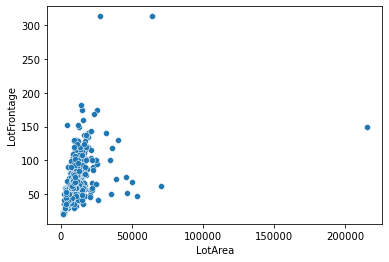

In [8581]:
#scatter plot between 'LotFrontage' & 'LotArea'

sns.scatterplot(data=housing, x='LotArea', y='LotFrontage')
plt.show()

Looks like there are some outliers. Let's check that in boxplot

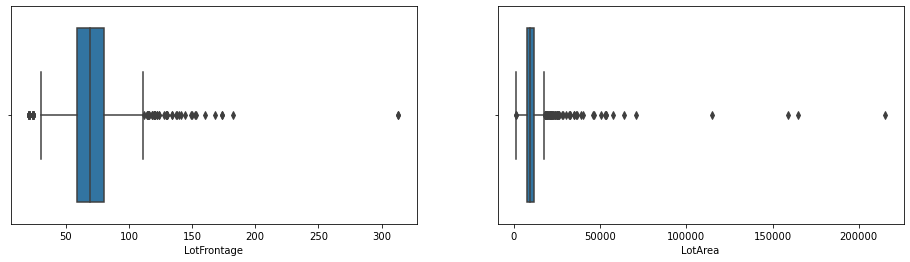

In [8582]:
#Boxplot to check for outliers in 'LotFrontage' & 'LotArea'

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.boxplot(housing['LotFrontage'], ax=ax[0])
sns.boxplot(housing['LotArea'], ax=ax[1])
plt.show()

In [8583]:
#check the percentiles of 'LotFrontage' to identify outliers

housing['LotFrontage'].describe(percentiles=[0, 0.25, 0.5, 0.75, 0.8, 0.9, 0.95, 0.98, 0.99, 1.0])

count    1201.000000
mean       70.049958
std        24.284752
min        21.000000
0%         21.000000
25%        59.000000
50%        69.000000
75%        80.000000
80%        85.000000
90%        96.000000
95%       107.000000
98%       124.000000
99%       141.000000
100%      313.000000
max       313.000000
Name: LotFrontage, dtype: float64

In [8584]:
#check the number of observation in 'LotFrontage' which has values above 98th percentile(124.0)

housing[housing['LotFrontage'] > 124.0].shape

(24, 78)

In [8585]:
#checking the percentiles of 'LotArea' to identify outliers

housing['LotArea'].describe(percentiles=[0, 0.25, 0.5, 0.75, 0.8, 0.9, 0.95, 0.98, 0.99, 1.0])

count      1460.000000
mean      10516.828082
std        9981.264932
min        1300.000000
0%         1300.000000
25%        7553.500000
50%        9478.500000
75%       11601.500000
80%       12205.800000
90%       14381.700000
95%       17401.150000
98%       25251.620000
99%       37567.640000
100%     215245.000000
max      215245.000000
Name: LotArea, dtype: float64

In [8586]:
#check the number of observation in 'LotArea' which has values above 98th percentile(25251.62)

housing[housing['LotArea'] > 25251.62].shape

(30, 78)

In [8587]:
#check the number of records which has outliers in any one of the observation of `LotFrontage` & `LotArea`

housing[(housing['LotFrontage'] > 124.0) | (housing['LotArea'] > 25251.62)].shape

(48, 78)

In [8588]:
#check the percentage of values having outliers in `LotFrontage` & `LotArea`

100 * (48/housing.shape[0])

3.287671232876712

Only 3% of the records have outliers in `LotFrontage` & `LotArea` <br/>
So, we can remove those observation

In [8589]:
#Extract all the records without outliers in `LotFrontage` & `LotArea` to a new dataframe 'housing2'

housing2 = housing[~((housing['LotFrontage'] > 124.0) | (housing['LotArea'] > 25251.62))]

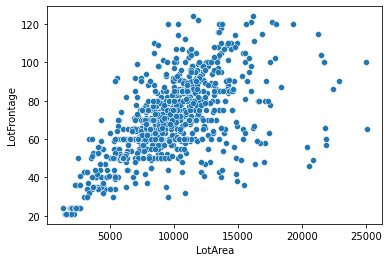

In [8590]:
#scatter plot between `LotFrontage` & `LotArea` after removing outliers

sns.scatterplot(data=housing2, x='LotArea', y='LotFrontage')
plt.show()

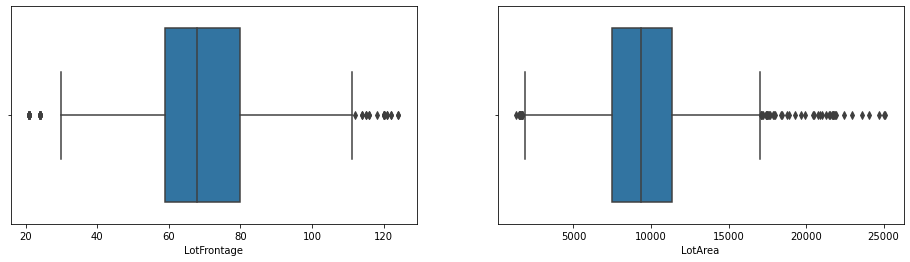

In [8591]:
#checking the outliers for 'LotFrontage' & 'LotArea' after cleaning

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.boxplot(housing2['LotFrontage'], ax=ax[0])
sns.boxplot(housing2['LotArea'], ax=ax[1])
plt.show()

**we have removed the extreme outliers in `LotFrontage` & `LotArea`**

In [8592]:
# checking correlation between 'LotFrontage' & 'LotArea' after cleaning

100 * (housing2['LotFrontage'].corr(housing2['LotArea']))

65.68584784900878

**65.6% correlation** between 'LotFrontage' & 'LotArea' after cleaning outliers

**Now Let's build a linear model between 'LotFrontage' & 'LotArea' to find the missing 18% missing values in** `LotFrontage`

In [8593]:
#omitting the missing observation 'LotFrontage'

housing2 = housing2[~(housing2['LotFrontage'].isnull())]

In [8594]:
#Extracting only 'LotFrontage' & 'LotArea' for model building

housing2 = housing2[['LotFrontage', 'LotArea']]

In [8595]:
#check if there are any missing values

housing2.isnull().sum()

LotFrontage    0
LotArea        0
dtype: int64

In [8596]:
#Extracting X & y values for the model

X = housing2['LotArea'].values.reshape(-1, 1)
y = housing2['LotFrontage']

In [8597]:
#Import library for splitting train & test data

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

In [8598]:
#importing library for Linear Regression

from sklearn.linear_model import LinearRegression

#Build a Linear regression model
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [8599]:
#prediction for 'X_train' & 'X_test' with the model

y_pred_train = lr.predict(X_train)
y_pred_test = lr.predict(X_test)

In [8600]:
#checking r2 Score for the model between 'LotFrontage' & 'LotArea'

from sklearn.metrics import r2_score, mean_squared_error

#checking r2 Score on train set
print('train r2 score:', r2_score(y_train, y_pred_train))

#checking r2 Score on test set
print('test r2 score:', r2_score(y_test, y_pred_test))

train r2 score: 0.43170535523053155
test r2 score: 0.4297158720452052


In [8601]:
#metrics to access model performance

rss =  np.sum(np.square(y_test - y_pred_test))
print('RSS:', rss)

mse = mean_squared_error(y_test, y_pred_test)
print('MSE:', mse)

rmse = mse ** 0.5
print("RMSE", rmse)

RSS: 74716.03409592985
MSE: 213.47438313122814
RMSE 14.610762578703007


<function matplotlib.pyplot.show(close=None, block=None)>

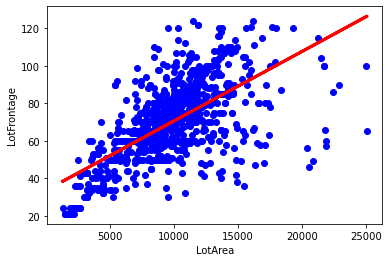

In [8602]:
#visualising model fit between 'LotArea' & 'LotFrontage'

plt.scatter(X, y, color='blue')
plt.plot(X, lr.predict(X), color='red', linewidth=3)
plt.xlabel('LotArea')
plt.ylabel('LotFrontage')
plt.show

In [8603]:
#check the model coefficients

print('Intercept:', lr.intercept_)
print('Coef:', lr.coef_)

Intercept: 33.544511618637664
Coef: [0.00370527]


In [8604]:
#residual analysis
#y_res = y - y_predicted

#y_res = y - lr.predict(X)

<AxesSubplot:xlabel='LotFrontage', ylabel='Density'>

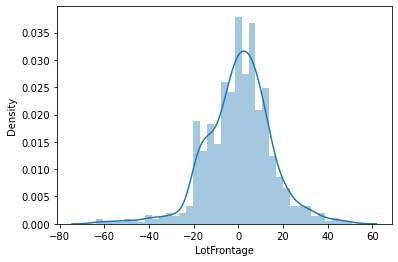

In [8605]:
#check the distplot of y_res

#sns.distplot(y_res,kde=True)

In [8606]:
#checking

#len(lr.predict(housing[housing['LotFrontage'].isnull()]['LotArea'].values.reshape(-1, 1)))

In [8607]:
#checking

#len(housing[housing['LotFrontage'].isnull()]['LotFrontage'])

In [8608]:
#Predict the 'LotFrontage' with 'LotArea' values

LotFrontage_predicted = pd.Series(lr.predict(housing['LotArea'].values.reshape(-1, 1)))

In [8609]:
#imputing only the missing values in 'LotFrontage' with predicted values for corresponding 'LotArea'

housing['LotFrontage'].fillna(LotFrontage_predicted, inplace=True)

In [8610]:
#round the 'LotFrontage' values with one digit float

housing['LotFrontage'] = housing['LotFrontage'].apply(lambda lf: round(lf, 1))

In [8611]:
#removing the outliers on 'LotFrontage' & 'LotArea'

housing = housing[~((housing['LotFrontage'] > 124.0) | (housing['LotArea'] > 25251.62))]

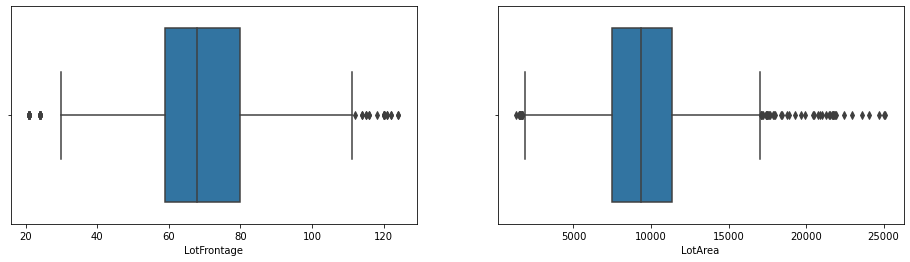

In [8612]:
#checking the outliers for 'LotFrontage' & 'LotArea' after cleaning

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.boxplot(housing3['LotFrontage'], ax=ax[0])
sns.boxplot(housing3['LotArea'], ax=ax[1])
plt.show()

In [8613]:
#returns the first five rows in the 'Housing' Dataframe

housing.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,Fence,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,no,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,no,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,no,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,no,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,no,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,no,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,no,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,no,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,no,0,12,2008,WD,Normal,250000


In [8614]:
#Drop the 'Id' column from the 'Housing' Dataframe

housing.drop(columns=['Id'], inplace=True)

### MSSubClass: Identifies the type of dwelling involved in the sale

In [8615]:
#checking value counts of 'MSSubClass'

housing['MSSubClass'].value_counts()

20     514
60     284
50     139
120     87
30      67
160     63
70      59
80      58
90      52
190     27
85      20
75      15
45      12
180     10
40       4
Name: MSSubClass, dtype: int64

**As per the 'MSSubClass' in the dictionary, the number in the column represents the below categories**

MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES

So, let's convert the 'MSSubClass' from 'int64' to 'object'

In [8616]:
#convert 'int64' to 'object' because the numbers in the column respresent a category

housing['MSSubClass'] = housing['MSSubClass'].astype('object')

### OverallQual: Rates the overall material and finish of the house
### OverallCond: Rates the overall condition of the house

**As per the 'OverallQual' & 'OverallCond' data in the dictionary, the number in the column represent below categories**

OverallQual: Rates the overall material and finish of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average
       5	Average
       4	Below Average
       3	Fair
       2	Poor
       1	Very Poor
	
OverallCond: Rates the overall condition of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average	
       5	Average
       4	Below Average	
       3	Fair
       2	Poor
       1	Very Poor

In [8617]:
# converting 'OverallQual', 'OverallCond' columns from 'int64' to 'object'

housing['OverallQual'] = housing['OverallQual'].astype('object')
housing['OverallCond'] = housing['OverallCond'].astype('object')

In [8618]:
#len(housing['GarageYrBlt'].value_counts())

### MoSold: Month Sold (MM)

In [8619]:
#check the value counts 'MoSold'

housing['MoSold'].value_counts()

6     239
7     230
5     201
4     137
8     120
3      98
10     88
11     75
9      60
12     58
1      54
2      51
Name: MoSold, dtype: int64

In [8620]:
#convert 'month' from int to category by mapping the appropriate month name

housing['MoSold'] = housing['MoSold'].map({1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun', 7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'})

In [8621]:
#check the value counts 'MoSold'

housing['MoSold'].value_counts()

Jun    239
Jul    230
May    201
Apr    137
Aug    120
Mar     98
Oct     88
Nov     75
Sep     60
Dec     58
Jan     54
Feb     51
Name: MoSold, dtype: int64

In [8622]:
#check the length of value_counts in 'YearBuilt', 'YearRemodAdd', 'YrSold'

print(len(housing['YearBuilt'].value_counts()))
print(len(housing['YearRemodAdd'].value_counts()))
print(len(housing['YrSold'].value_counts()))

112
61
5


**Instead of keeping the year values literally,**

**we can derive data like the**<br/>
    **- Age of the house between built & sold**<br/>
    **- Age of the house between remodelling & sold**

In [8623]:
#Driving the values of total Age of the house between built & sold

housing['houseAge'] = housing['YrSold'] - housing['YearBuilt']

In [8624]:
#Driving the values of total Age of the house remodelling & sold

housing['remodelAge'] = housing['YrSold'] - housing['YearRemodAdd']

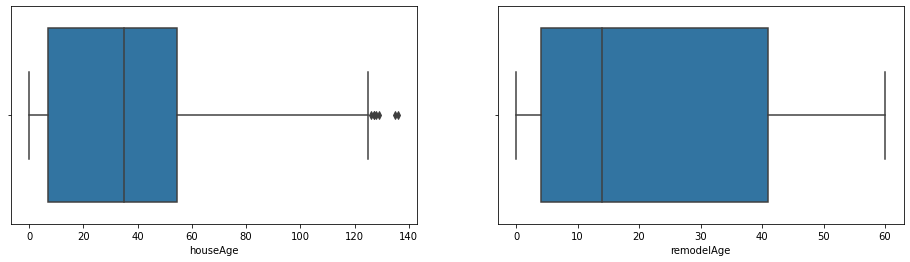

In [8625]:
#Boxplot to check the spread 'houseAge' & 'remodelAge'

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.boxplot(housing['houseAge'], ax=ax[0])
sns.boxplot(housing['remodelAge'], ax=ax[1])
plt.show()

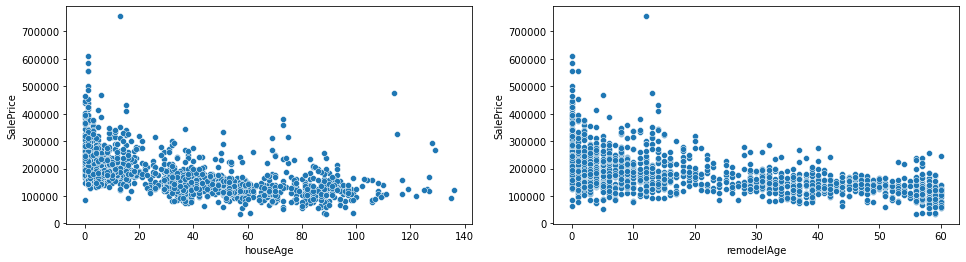

In [8626]:
#Scatterplot between 'houseAge' & 'remodelAge' with 'SalePrice'

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.scatterplot(data=housing, x='houseAge', y='SalePrice', ax=ax[0])
sns.scatterplot(data=housing, x='remodelAge', y='SalePrice', ax=ax[1])
plt.show()

**As the age of the house or remodeling time period increase, 'salePrice' decrease**

We can remove the outliers of 'houseAge' above higher fence<br/>

Upper fence = Q3 + (1.5 * IQR)

In [8627]:
#check the percentiles of 'houseAge'

housing['houseAge'].describe()

count    1411.000000
mean       36.540043
std        30.385262
min         0.000000
25%         7.000000
50%        35.000000
75%        54.500000
max       136.000000
Name: houseAge, dtype: float64

In [8628]:
#calculating the upper fence of 'houseAge'

UpperFenceAge = housing['houseAge'].quantile(0.75) + (1.5 * (housing['houseAge'].quantile(0.75) - housing['houseAge'].quantile(0.25)))
UpperFenceAge

125.75

In [8629]:
#check the number of records above the upperfence 

housing[(housing['houseAge'] >= UpperFenceAge)].shape

(7, 79)

In [8630]:
#remove the observation above the upperfence in 'houseAge'

housing = housing[~(housing['houseAge'] >= UpperFenceAge)]

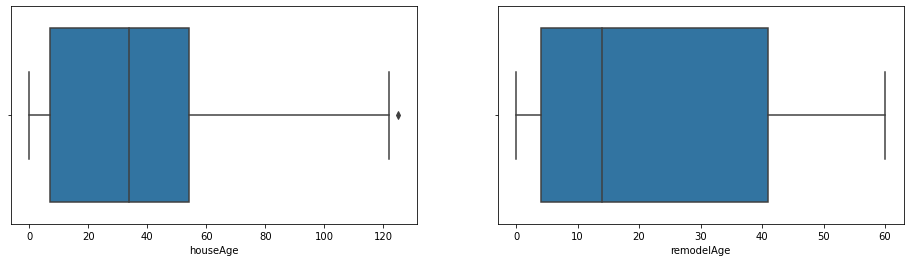

In [8631]:
#to check the spread 'houseAge' & 'remodelAge' after cleaning outliers

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.boxplot(housing['houseAge'], ax=ax[0])
sns.boxplot(housing['remodelAge'], ax=ax[1])
plt.show()

### GarageYrBlt: Year garage was built

Like deriving 'houseAge' & 'remodelAge' from 'YearBuilt', 'YearRemodAdd', 'YrSold'<br/>
**We can derive 'garageAge' with 'YrSold' & 'GarageYrBlt'**

In [8632]:
#convert the type of 'GarageYrBlt' from float to int

housing['GarageYrBlt'] = housing['GarageYrBlt'].astype('int64')

In [8633]:
#Deriving a new variable 'garageAge' when sold by subtracting 'GarageYrBlt' from 'YrSold'

housing['garageAge'] = housing['YrSold'] - housing['GarageYrBlt']

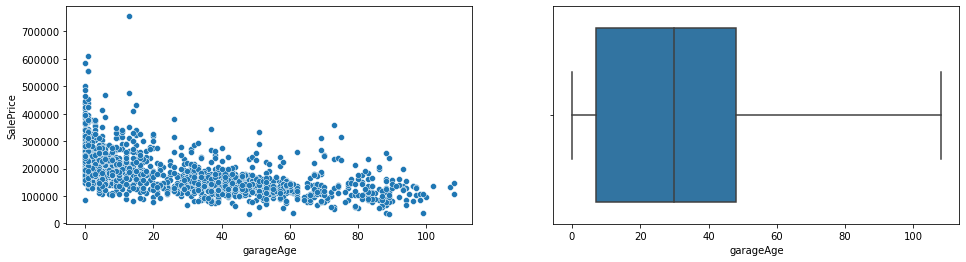

In [8634]:
#check the scatter plot between 'garageAge' & 'SalePrice'
#Boxplot to check the spread of 'garageAge'

fig, ax = plt.subplots(1,2, figsize=(16,4))
sns.scatterplot(data=housing, x='garageAge', y='SalePrice', ax=ax[0])
sns.boxplot(housing['garageAge'], ax=ax[1])
plt.show()

From the above scatterplot, it's clear that the 'SalePrice' decreases when 'garageAge increases'

In [8635]:
# we have derived the necessary data from 'YearBuilt', 'YrSold', 'YearRemodAdd','GarageYrBlt'
# So, we can drop the year columns such as 'YearBuilt', 'YrSold', 'YearRemodAdd','GarageYrBlt' from the dataframe

housing.drop(columns=['YearBuilt', 'YrSold', 'YearRemodAdd','GarageYrBlt'], inplace=True)

### LandContour: Flatness of the property

In [8636]:
#checking the value counts for'LandContour'

housing['LandContour'].value_counts()

Lvl    1281
Bnk      55
HLS      43
Low      25
Name: LandContour, dtype: int64

### Extracting categorical columns

In [8637]:
#select all categorical columns

housing_category = housing.select_dtypes(include=['object'])

housing_category.head()

,MSSubClass,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,Fence,MoSold,SaleType,SaleCondition
0,60,RL,Pave,no,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,no,Attchd,RFn,TA,TA,Y,no,Feb,WD,Normal
1,20,RL,Pave,no,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,Gable,CompShg,MetalSd,MetalSd,None,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,no,May,WD,Normal
2,60,RL,Pave,no,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,no,Sep,WD,Normal
3,70,RL,Pave,no,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,Wd Sdng,Wd Shng,None,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,no,Feb,WD,Abnorml
4,60,RL,Pave,no,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,no,Dec,WD,Normal


### Extracting numerical columns

In [8638]:
#select all numerical columns

housing_numeric = housing.select_dtypes(include=['float64', 'int64'])

housing_numeric.head()

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,MiscVal,SalePrice,houseAge,remodelAge,garageAge
0,65.0,8450,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2,548,0,61,0,0,0,0,208500,5,5,5
1,80.0,9600,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,2,460,298,0,0,0,0,0,181500,31,31,31
2,68.0,11250,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2,608,0,42,0,0,0,0,223500,7,6,7
3,60.0,9550,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,3,642,0,35,272,0,0,0,140000,91,36,8
4,84.0,14260,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,3,836,192,84,0,0,0,0,250000,8,8,8


**Sum of the columns 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF' makes the 'TotalBsmtSF'**

In [8639]:
#summing of 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF' makes the 'TotalBsmtSF' 

(housing_numeric['BsmtFinSF1'] + housing_numeric['BsmtFinSF2'] + housing_numeric['BsmtUnfSF']).equals(housing_numeric['TotalBsmtSF'])

True

summing of 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF' makes the 'TotalBsmtSF'<br/>
so, we can drop 'TotalBsmtSF'

In [8640]:
#drop 'TotalBsmtSF' column

housing_numeric.drop(columns=['TotalBsmtSF'], inplace=True)

**Sum of the columns '1stFlrSF', '2ndFlrSF', 'LowQualFinSF' makes 'GrLivArea'**

In [8641]:
#summing of '1stFlrSF', '2ndFlrSF', 'LowQualFinSF' makes 'GrLivArea'

(housing_numeric['1stFlrSF'] + housing_numeric['2ndFlrSF'] + housing_numeric['LowQualFinSF']).equals(housing_numeric['GrLivArea'])

True

summing of '1stFlrSF', '2ndFlrSF', 'LowQualFinSF' makes 'GrLivArea' <br/>
so, we can drop 'GrLivArea'

In [8642]:
#Drop 'GrLivArea'

housing_numeric.drop(columns=['GrLivArea'], inplace=True)

### BsmtFullBath: Basement full bathrooms

In [8643]:
#checking the value counts of 'BsmtFullBath'

housing_numeric['BsmtFullBath'].value_counts()

0    832
1    561
2     10
3      1
Name: BsmtFullBath, dtype: int64

### FullBath: Full bathrooms above grade

In [8644]:
#checking the value counts of 'FullBath'

housing_numeric['FullBath'].value_counts()

2    740
1    631
3     25
0      8
Name: FullBath, dtype: int64

### BsmtHalfBath: Basement half bathrooms

In [8645]:
#checking the value counts 'HalfBath'

housing_numeric['HalfBath'].value_counts()

0    880
1    512
2     12
Name: HalfBath, dtype: int64

### Bedroom: Bedrooms above grade (does NOT include basement bedrooms)

In [8646]:
#checking the value counts 'BedroomAbvGr'

housing_numeric['BedroomAbvGr'].value_counts()

3    777
2    348
4    197
1     50
5     19
6      7
0      5
8      1
Name: BedroomAbvGr, dtype: int64

### Kitchen: Kitchens above grade

In [8647]:
#checking the value counts 'KitchenAbvGr'

housing_numeric['KitchenAbvGr'].value_counts()

1    1337
2      64
3       2
0       1
Name: KitchenAbvGr, dtype: int64

### OverallQual: Rates the overall material and finish of the house

*As per the distionary in the data, the number in 'OverallQual' refers to a category**

OverallQual: Rates the overall material and finish of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average
       5	Average
       4	Below Average
       3	Fair
       2	Poor
       1	Very Poor

**So, map 'OverallQual' to the category word**

In [8648]:
#mapping number category to word in 'OverallQual'

housing_category['OverallQual'] = housing_category['OverallQual'].map({1: 'V_poor', 2: 'Poor', 3: 'Fair', 4: 'Bel_avg', 5: 'Avg', 6: 'Abv_avg', 7: 'Good', 8: 'V_good', 9: 'Excellent', 10: 'V_Excel'})


### OverallCond: Rates the overall condition of the house

*As per the distionary in the data, the number in 'OverallCond' refers to a category**

OverallQual: Rates the overall material and finish of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average
       5	Average
       4	Below Average
       3	Fair
       2	Poor
       1	Very Poor

**So, map 'OverallCond' to the category word**

In [8649]:
#mapping number category to word in 'OverallCond'

housing_category['OverallCond'] = housing_category['OverallCond'].map({1: 'V_poor', 2: 'Poor', 3: 'Fair', 4: 'Bel_avg', 5: 'Avg', 6: 'Abv_avg', 7: 'Good', 8: 'V_good', 9: 'Excellent', 10: 'V_Excel'})

In [8650]:
#convert all the category columns into dummy variables
#As i want to interpret variable, i'm not using drop_first

housing_cat_dummies = pd.get_dummies(housing_category, drop_first=True)

In [8651]:
housing_cat_dummies

,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_Pave,Alley_no,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,...,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageQual_no,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,GarageCond_no,PavedDrive_P,PavedDrive_Y,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_no,MoSold_Aug,MoSold_Dec,MoSold_Feb,MoSold_Jan,MoSold_Jul,MoSold_Jun,MoSold_Mar,MoSold_May,MoSold_Nov,MoSold_Oct,MoSold_Sep,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
3,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
5,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
7,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
8,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0


In [8652]:
#check the number of columns & rows in categorical dummy variables

housing_cat_dummies.shape

(1404, 256)

In [8653]:
#to cross verify the number of columns created

cat = 0

for i in housing_category.columns:
    cat += len(housing_category[i].value_counts())
    
print(cat)

301


In [8654]:
#check the number of columns & rows in numerical  variables

housing_numeric.shape

(1404, 29)

In [8655]:
#merge two dataframe 'housing_numeric' & 'housing_cat_dummies'

housing_fin = pd.concat([housing_numeric, housing_cat_dummies], axis = 1)

housing_fin.head()

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,MiscVal,SalePrice,houseAge,remodelAge,garageAge,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,...,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageQual_no,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,GarageCond_no,PavedDrive_P,PavedDrive_Y,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_no,MoSold_Aug,MoSold_Dec,MoSold_Feb,MoSold_Jan,MoSold_Jul,MoSold_Jun,MoSold_Mar,MoSold_May,MoSold_Nov,MoSold_Oct,MoSold_Sep,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,65.0,8450,196.0,706,0,150,856,854,0,1,0,2,1,3,1,8,0,2,548,0,61,0,0,0,0,208500,5,5,5,0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1,80.0,9600,0.0,978,0,284,1262,0,0,0,1,2,0,3,1,6,1,2,460,298,0,0,0,0,0,181500,31,31,31,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
2,68.0,11250,162.0,486,0,434,920,866,0,1,0,2,1,3,1,6,1,2,608,0,42,0,0,0,0,223500,7,6,7,0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
3,60.0,9550,0.0,216,0,540,961,756,0,1,0,1,0,3,1,7,1,3,642,0,35,272,0,0,0,140000,91,36,8,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
4,84.0,14260,350.0,655,0,490,1145,1053,0,1,0,2,1,4,1,9,1,3,836,192,84,0,0,0,0,250000,8,8,8,0,0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0


In [8656]:
#checking the shape

housing_fin.shape

(1404, 285)

In [8657]:
#checking the column length

len(housing_fin.columns)

285

In [8658]:
housing_fin = housing_fin.loc[:,~(housing_fin.columns.duplicated())]
housing_fin.shape

(1404, 285)

In [8659]:
#copy of housing dataframe

housing_fin2 = housing_fin.copy()

### Data visualisation - Numerical column 

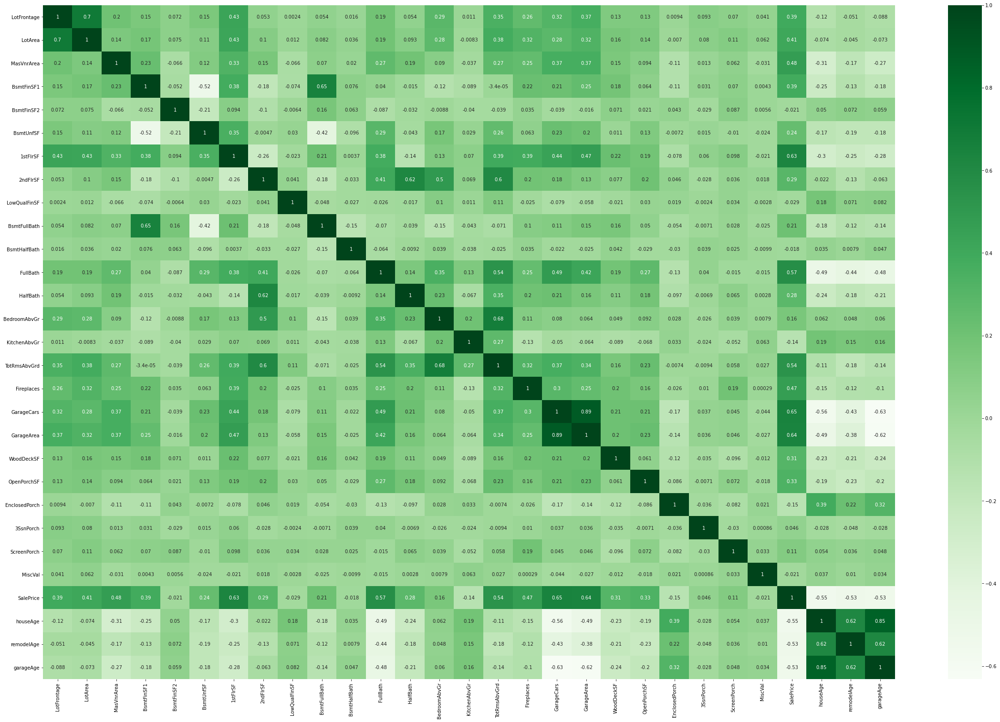

In [8660]:
# plotting correlations on a heatmap on numeric variable

# figure size
plt.figure(figsize=(40,26))

# heatmap
sns.heatmap(housing_numeric.corr(), cmap="Greens", annot=True)
plt.show()

In [8661]:
#correlation DataFrame of numeric variables in housing dataframe

housing_numeric_corr = housing_numeric.corr()

In [8662]:
#Extract the 'SalePrice' correlation and sort values
corr_SalePrice = housing_numeric_corr[['SalePrice']].sort_values('SalePrice', ascending=False)

In [8663]:
#Extract the correlation above 0.3 or -0.3

corr_SalePrice = corr_SalePrice[(corr_SalePrice['SalePrice'] > 0.5) | (corr_SalePrice['SalePrice'] < -0.4)]
corr_SalePrice

,SalePrice
SalePrice,1.000000
GarageCars,0.649274
GarageArea,0.640617
1stFlrSF,0.631608
FullBath,0.568105
TotRmsAbvGrd,0.536174
remodelAge,-0.526106
garageAge,-0.534569
houseAge,-0.553861


In [8664]:
#list of high correlated columns

housing_high_corr = list(corr_SalePrice.index)
housing_high_corr

['SalePrice',
 'GarageCars',
 'GarageArea',
 '1stFlrSF',
 'FullBath',
 'TotRmsAbvGrd',
 'remodelAge',
 'garageAge',
 'houseAge']

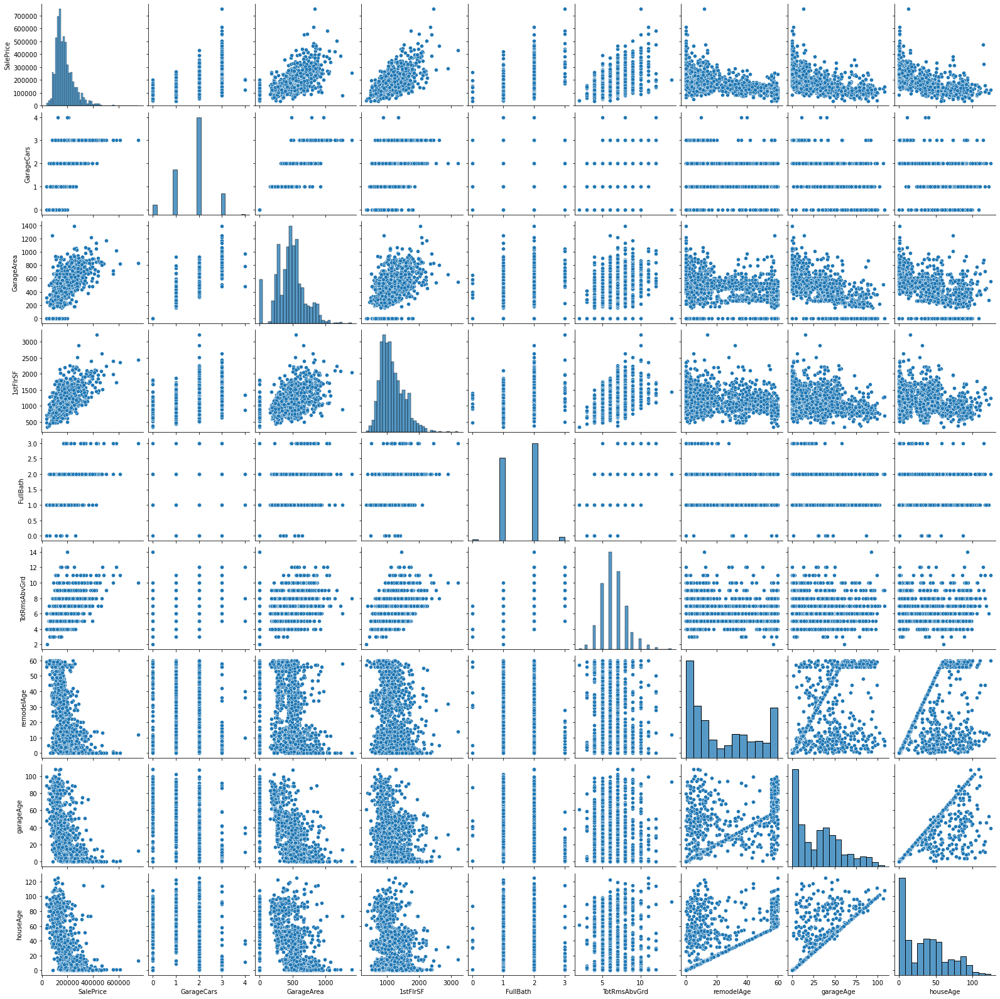

In [8665]:
#pairplot for variables in 'corr_SalePrice'

sns.pairplot(housing_fin[housing_high_corr])
plt.show()

**Insights from the Numerical columns**<br/>
    - As the house age increases, sale price decreases<br/>
    - As the remodel year increases, sale price decreases<br/>
    - As the garage age increases, sale price decreases<br/>
    - As the squarefeet of first floor increases, sale price increases<br/>
    - As the size of the Garage are increases, sale price increases<br/>

### Data visualisation - Categorical column 

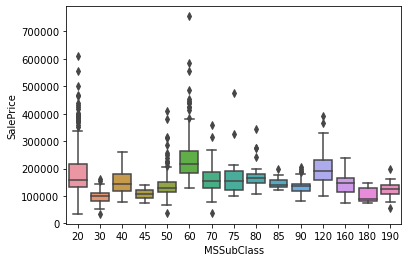

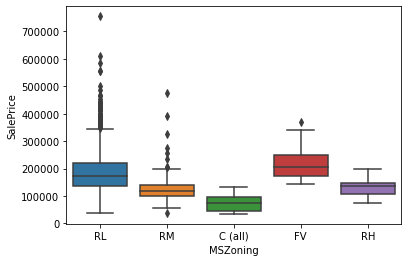

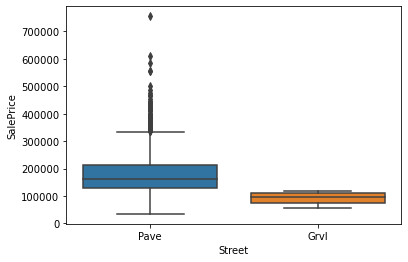

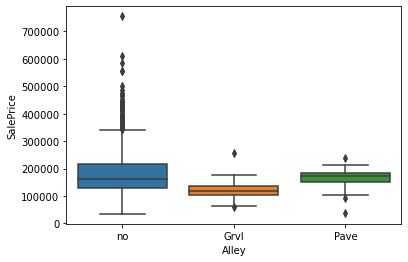

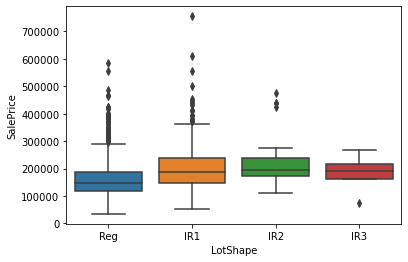

...

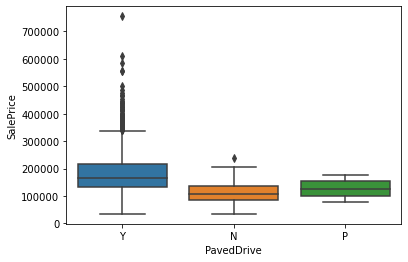

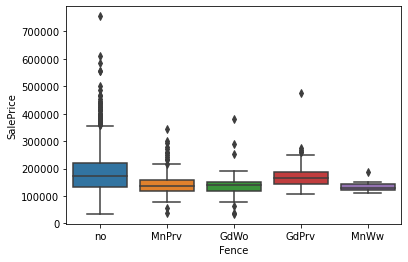

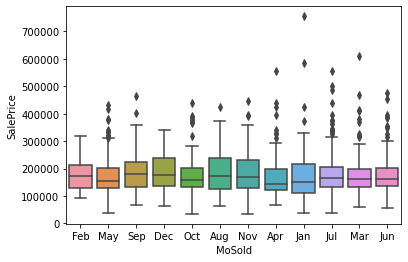

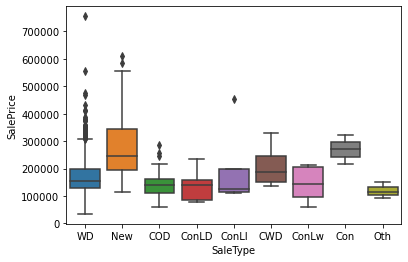

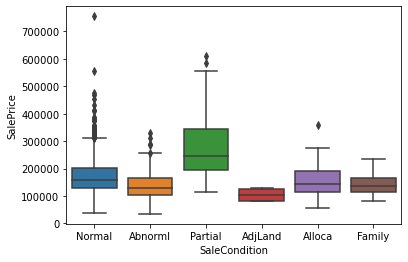

In [8666]:
for i in housing_category.columns:
    sns.boxplot(x=i, y='SalePrice', data=housing)
    plt.show()

**Insights from the Categorical columns**<br/>
    - 'street' - road access to property with 'pave' category has higher sale price when compared to 'Grvl'<br/>
    - 'OveralQual' - As the overall quality of housing increases, sale price increases<br/>
    - 'OveralCond' - As the overall condition of housing increases, sale price increases<br/>
    - 'ExterQual' - 'Excellent' & 'Good' quality of the material on the exterior sold for higher price when compare to other category<br/>
    - 'ExterCond' - 'Excellent' quality of exterior condition sold for higher price when compare to other category<br/>
    - 'BsmtQual' with 100+ inches sold for higher price when compare to other category<br/>
    - 'CentralAir' House with Central air conditioning sold for higher price when compare to other category<br/>
    - 'KitchenQual' - kitchen with Excellent quality sold for higher price when compare to other category<br/>
    - 'FirePlaceQu' - Fireplace with Excellent quality sold for higher price when compare to other category<br/>
    - 'GarageType' - Builtin category in Garage sold for higher price when compare to other category<br/>
    - 'SaleCondition' - 'Partial' category in SaleCondition sold for higher price when compare to other category

## Train Test data split & Data Preparation

let's split the data into train & test to build the Linear Regression model

In [8667]:
# We specify this so that the train and test data set always have the same rows, respectively
np.random.seed(0)

#split the data info train & test data
housing_train, housing_test = train_test_split(housing_fin, train_size=0.7, test_size=0.3, random_state=100)

In [8668]:
#check the shape of train set

housing_train.shape

(982, 285)

In [8669]:
#check the shape of test set

housing_test.shape

(422, 285)

## Multiple Linear Regression

Our target variable 'SalePrice' in number. So, let's build Linear regression model

In [8670]:
#Extract the target variable as 'y_train' & predictor variable as 'X_train' from the train set

y_train = housing_train.pop('SalePrice')
X_train = housing_train

In [8671]:
#Extract the target variable as 'y_test' & predictor variable as 'X_test' from the test set

y_test = housing_test.pop('SalePrice')
X_test = housing_test

In [8672]:
#Create a LinearRegression model & fit it

housing_mod = LinearRegression()
housing_mod.fit(X_train, y_train)

LinearRegression()

In [8673]:
#predict y_prediction on both train & test set

y_pred_train = housing_mod.predict(X_train)
y_pred_test = housing_mod.predict(X_test)

In [8674]:
#checking r2 Score for train & set set

from sklearn.metrics import r2_score, mean_squared_error

#checking r2 Score on train set
print('train r2_score:', r2_score(y_train, y_pred_train))

#checking r2 Score on test set
print('test r2_score:', r2_score(y_test, y_pred_test))

train r2_score: 0.9536295251174657
test r2_score: 0.8834611469199138


**Train r2_score is 95% & Test r2_score is 88%**

**Clearly, it's a sign of overfitting**

In [8675]:
#check the intercept & co-efficient values

print(housing_mod.intercept_)
print(housing_mod.coef_)

62692.23408452532
[-4.85858199e+01  1.33491370e+00  2.58845001e+01  3.92308064e+01
  3.40387173e+01  1.89202468e+01  5.32407359e+01  5.95749782e+01
  4.00541082e+01  3.10540720e+03  3.75704969e+03  2.51589323e+03
 -1.12407362e+03 -5.93767624e+03 -1.10284968e+04  2.07863646e+03
  5.36407071e+03  4.51581735e+03  1.24110960e+01  4.83583603e+00
  6.14967419e+00  2.44322218e+01 -4.61937650e+00  4.77684887e+01
  9.92286638e-01 -4.88604256e+02 -1.04333784e+02  2.76877524e+01
  6.32395901e+03  6.66924024e+03 -5.86371266e+03 -6.04581099e+02
  5.33918542e+03  1.27821256e+04  1.66791237e+04 -6.38807030e+03
 -1.49003581e+04 -8.08010289e+03 -1.51886863e+03 -1.08777950e+03
 -8.01234098e+03  9.24822597e+03  1.75419746e+04  1.35691411e+04
  1.76920773e+04  1.24193707e+04  1.35193924e+03  5.62823800e+03
  4.54547876e+03  5.61610801e+03 -4.35236753e+03  7.48055316e+02
 -1.02421703e+04 -2.20869052e+04 -7.55072302e+03 -9.60426405e-10
  3.38781611e+03 -2.55341927e+03  4.99736071e+03 -2.52792925e+02
  2.524

In [8676]:
#find r2_score, rss, mse for train & test data in Linear Regression

metric = []
r2_train_lr = r2_score(y_train, y_pred_train)
print('r2_score train_lr:', r2_train_lr)
metric.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print('r2_score test_lr:', r2_test_lr)
metric.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print('rss_train_lr:', rss1_lr)
metric.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print('rss_test_lr:',rss2_lr)
metric.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print('mse_train_lr:', mse_train_lr)
metric.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print('mse_test_lr:', mse_test_lr)
metric.append(mse_test_lr**0.5)

r2_score train_lr: 0.9536295251174657
r2_score test_lr: 0.8834611469199138
rss_train_lr: 270944897171.25595
rss_test_lr: 269623394551.25058
mse_train_lr: 275911300.581727
mse_test_lr: 638917996.5669445


In [8677]:
#Extracting y value from 'SalePrice' column

y = housing_fin['SalePrice']
y = y.values.reshape(-1, 1)
y.shape

(1404, 1)

In [8678]:
#Extracting all columns except target variable

X = housing_fin.loc[:, housing_fin.columns != 'SalePrice']

X.shape

(1404, 284)

In [8679]:
#predict the y_pred value with X variable

y_pred = pd.Series(housing_mod.predict(X))

y_pred = y_pred.values.reshape(-1, 1)
y_pred.shape

(1404, 1)

In [8680]:
#residual = y - y_pred

y_residual = y - y_pred
y_residual

array([[  -436.92146359],
       [-21837.97708107],
       [ 17671.83175701],
       ...,
       [  8272.88302241],
       [  8188.17368959],
       [ -3911.51808749]])

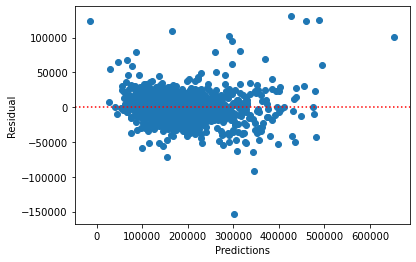

In [8681]:
#prediction vs residual plot

plt.scatter( y_pred , y_residual)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Predictions")
plt.ylabel("Residual")
plt.show()

Looks like the residual has extreme values

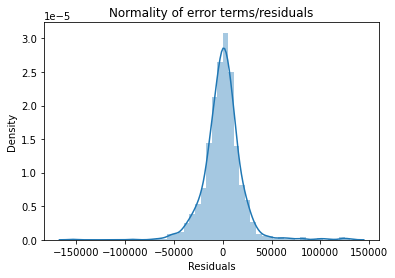

In [8682]:
# Distribution of errors
p = sns.distplot(y_residual,kde=True)

p = plt.title('Normality of error terms/residuals')
plt.xlabel("Residuals")
plt.show()

Residuals are normally distributed

## Ridge Regression

Since we have so many variables, we are running in to the Overfitting problem.<br/>

To reduce the overfitting of the model,<br/>
**ridge regression which adds (lambda * sum of square of co-efficient) as penalty with RSS in the cost function**<br/>

This helps to shrink the co-efficent in the model which reduces overfitting<br/>


\begin{equation}
  Ridge Cost function = \sum_{i=1}^{n} (y_{i} - \hat{y})^{2} + \lambda \sum_{j=1}^{p} \beta _{j}^{2}
\end{equation}

In [8683]:
# We specify this so that the train and test data set always have the same rows, respectively
np.random.seed(0)

#split the data info train & test data
housing_train, housing_test = train_test_split(housing_fin2, train_size=0.7, test_size=0.3, random_state=100)

Scaling the continuous variables is important for Ridge & Lasso regression. <br/>
So, let's scale the continuous variable on the data frame

In [8684]:
#import library for MinMaxScaler
from sklearn.preprocessing import MinMaxScaler

#create a MinMaxScaler object to rescale
scale = MinMaxScaler()


#list of continuous variable
cont_vars = list(housing_fin2.select_dtypes(include=['float64', 'int64']).columns)
#cont_vars

#scale the continuous variables in train
housing_train[cont_vars] = scale.fit_transform(housing_train[cont_vars])

#scale the continuous variables in test
housing_test[cont_vars] = scale.transform(housing_test[cont_vars])

print(housing_train.shape)
print(housing_test.shape)

(982, 285)
(422, 285)


In [8685]:
#Extract the target variable as 'y_train' & predictor variable as 'X_train' from the train set

y_train = housing_train.pop('SalePrice')
X_train = housing_train

In [8686]:
#Extract the target variable as 'y_test' & predictor variable as 'X_test' from the train set

y_test = housing_test.pop('SalePrice')
X_test = housing_test

In [8687]:
#import the Ridge regression & GridSearch library

from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

In [8688]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv.fit(X_train, y_train)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    1.6s finished


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [8689]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 2.0}


The best hyperparameter for alpha is 2.0<br/>
Let's do a second iteration to the nearby value to find the best alpha

In [8690]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting
params = {'alpha': [1.6, 1.7, 1.8, 1.9, 2.0, 2.1, 2.2, 2.3, 2.4, 2.5]}

ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.6s finished


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [1.6, 1.7, 1.8, 1.9, 2.0, 2.1, 2.2, 2.3, 2.4,
                                   2.5]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [8691]:
# Printing the best hyperparameter alpha
print(model_cv.best_params_)

{'alpha': 1.6}


let build the model with best alpha value 1.6

In [8692]:
#Fitting Ridge model for alpha = 1.6 and printing coefficients which have been penalised
alpha = 1.6
ridge = Ridge(alpha=alpha)

ridge.fit(X_train, y_train)
print(ridge.coef_)

[ 4.67472651e-03  4.00756074e-02  4.34979781e-02  9.41721642e-02
  3.62813530e-02  4.70019400e-02  1.36124088e-01  8.91569918e-02
  1.29910522e-02  1.03892525e-02  9.64473840e-03  2.76145250e-02
  8.02049882e-03 -2.69945146e-02 -3.04076798e-02  4.72005533e-02
  2.57387856e-02  2.45696483e-02  3.38322066e-02  9.61304853e-03
  1.25789855e-02  5.49735558e-03 -2.41151780e-03  2.85326515e-02
  1.32975157e-03 -4.64094265e-02 -1.21235201e-02 -1.10352861e-03
 -4.70588759e-04  1.30366863e-02  1.60551265e-03  3.94988327e-03
  7.56154036e-03  1.21054056e-02  3.96030357e-03 -5.66474202e-03
 -1.67677337e-02 -9.61059205e-03 -8.96473512e-03 -5.42078699e-03
 -8.29032177e-03 -4.98243893e-03  1.13890154e-02  9.34356890e-03
  1.45431559e-02  7.83514537e-03  7.26955446e-03  9.40558318e-03
  7.05460447e-03  1.11640735e-02  1.47461791e-03  1.30346918e-03
 -6.04816776e-03 -2.65385322e-02 -5.63936712e-03  0.00000000e+00
  9.05132640e-03 -4.72427171e-03  2.13644448e-03  6.24211693e-04
  4.20076440e-03 -2.15579

Ridge regression shrinks the co-efficients value closer to 0

In [8693]:
# Lets calculate some metrics such as R2 score, RSS and RMSE
y_pred_train = ridge.predict(X_train)
y_pred_test = ridge.predict(X_test)

metric2 = []
r2_train_ridge = r2_score(y_train, y_pred_train)
print('r2_train_ridge:', r2_train_ridge)
metric2.append(r2_train_ridge)

r2_test_ridge = r2_score(y_test, y_pred_test)
print('r2_test_ridge:', r2_test_ridge)
metric2.append(r2_test_ridge)

rss_train_ridge = np.sum(np.square(y_train - y_pred_train))
print('rss_train_ridge:', rss_train_ridge)
metric2.append(rss_train_ridge)

rss_test_ridge = np.sum(np.square(y_test - y_pred_test))
print('rss_test_ridge:', rss_test_ridge)
metric2.append(rss_test_ridge)

mse_train_ridge = mean_squared_error(y_train, y_pred_train)
print('mse_train_ridge: ', mse_train_ridge)
metric2.append(mse_train_ridge**0.5)

mse_test_ridge = mean_squared_error(y_test, y_pred_test)
print('mse_test_ridge:', mse_test_ridge)
metric2.append(mse_test_ridge**0.5)

r2_train_ridge: 0.9479982934723563
r2_test_ridge: 0.8981550850004854
rss_train_ridge: 0.5859646365435832
rss_test_ridge: 0.4544023416123081
mse_train_ridge:  0.0005967053325291071
mse_test_ridge: 0.001076782800029166


r2_score for test has improved in Ridge regression.
We have allowed some bias to reduce the variance significantly

## Lasso

We have used Ridge regression to reduce the overfitting.

**Ridge Regression have its own disadvantange. It uses all the variables in column to build model**

**Ridge Regression only shrinks the co-efficients near to zero but Lasso regression turns some of the co-efficients to 0 which should be considered as feature selection**

Equation for Lasso regression as follows

\begin{equation}
  Lasso Cost function = \sum_{i=1}^{n} (y_{i} - \hat{y})^{2} + \lambda \sum_{j=1}^{p} \left | \beta _{j} \right |
\end{equation}

In [8694]:
#import lasso library

from sklearn.linear_model import Lasso

In [8695]:
# list of alphas to tune - if value too high it will lead to underfitting, if it is too low, 
# it will not handle the overfitting

params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}


In [8696]:
lasso = Lasso()

# cross validation
model_cv = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

model_cv.fit(X_train, y_train) 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    1.5s finished


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3,
                                   0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0,
                                   4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50,
                                   100, 500, 1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [8697]:
# Printing the best hyperparameter alpha

print(model_cv.best_params_)

{'alpha': 0.0001}


In [8698]:
#Fitting Lass model for alpha = 0.0001 and printing coefficients which have been penalised

alpha =0.0001

lasso = Lasso(alpha=alpha)
        
lasso.fit(X_train, y_train) 

Lasso(alpha=0.0001)

In [8699]:
#check the co-efficients of lasso

lasso.coef_

array([ 0.00000000e+00,  2.89934418e-02,  4.06509203e-02,  8.42174248e-02,
        2.33115900e-02,  2.56013383e-02,  2.28027360e-01,  1.24537423e-01,
        6.73495051e-03,  2.37914450e-03,  6.46349281e-06,  4.75905572e-03,
        1.03429967e-03, -1.66935984e-02, -3.98462084e-02,  2.16138588e-02,
        1.57946042e-02,  1.68482503e-02,  3.12082530e-02,  2.92109854e-03,
        3.23483358e-03,  1.47070709e-03,  0.00000000e+00,  2.21920316e-02,
        0.00000000e+00, -5.58093540e-02, -1.15303608e-02, -0.00000000e+00,
       -0.00000000e+00,  0.00000000e+00,  2.54548762e-03,  1.88647849e-03,
        1.42204931e-03,  0.00000000e+00,  0.00000000e+00, -0.00000000e+00,
       -0.00000000e+00, -1.19420177e-02, -1.26927353e-03, -3.71629231e-03,
       -0.00000000e+00, -0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        7.46490902e-03, -0.00000000e+00,  0.00000000e+00,  6.36952395e-05,
        3.84543637e-05,  7.88282658e-03, -0.00000000e+00,  2.33280448e-04,
       -0.00000000e+00, -

Lasso Regression did feature elimination by turning some of the co-efficients into 0

In [8700]:
# Lets calculate some metrics such as R2 score, RSS and RMSE

y_pred_train = lasso.predict(X_train)
y_pred_test = lasso.predict(X_test)

metric3 = []
r2_train_lasso = r2_score(y_train, y_pred_train)
print('r2_train_lasso:', r2_train_lasso)
metric3.append(r2_train_lasso)

r2_test_lasso = r2_score(y_test, y_pred_test)
print('r2_test_lasso:', r2_test_lasso)
metric3.append(r2_test_lasso)

rss_train_lasso = np.sum(np.square(y_train - y_pred_train))
print('rss_train_lasso:', rss_train_lasso)
metric3.append(rss_train_lasso)

rss_test_lasso = np.sum(np.square(y_test - y_pred_test))
print('rss_test_lasso:', rss_test_lasso)
metric3.append(rss_test_lasso)

mse_train_lasso = mean_squared_error(y_train, y_pred_train)
print('mse_train_lasso', mse_train_lasso)
metric3.append(mse_train_lasso**0.5)

mse_test_lasso = mean_squared_error(y_test, y_pred_test)
print('mse_test_lasso:', mse_test_lasso)
metric3.append(mse_test_lasso**0.5)

r2_train_lasso: 0.9431494396833545
r2_test_lasso: 0.9055726402751734
rss_train_lasso: 0.6406023982219424
rss_test_lasso: 0.4213073708337175
mse_train_lasso 0.0006523446010406746
mse_test_lasso: 0.0009983586986580984


### Metric for Ridge & Lasso regression with Optimum alpha value

In [8701]:
# Creating a table which contain all the metrics

lr_table = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'RMSE (Train)','RMSE (Test)'], 
        'Linear Regression': metric
        }

lr_metric = pd.DataFrame(lr_table ,columns = ['Metric', 'Linear Regression'] )

rg_metric = pd.Series(metric2, name = 'Ridge Regression')
ls_metric = pd.Series(metric3, name = 'Lasso Regression')

final_metric = pd.concat([lr_metric, rg_metric, ls_metric], axis = 1)

final_metric

,Metric,Linear Regression,Ridge Regression,Lasso Regression
0,R2 Score (Train),9.536295e-01,0.947998,0.943149
1,R2 Score (Test),8.834611e-01,0.898155,0.905573
2,RSS (Train),2.709449e+11,0.585965,0.640602
3,RSS (Test),2.696234e+11,0.454402,0.421307
4,RMSE (Train),1.661058e+04,0.024428,0.025541
5,RMSE (Test),2.527683e+04,0.032814,0.031597


## Analyse the coefficients after Ridge & Lasso regularization

In [8702]:
#create a Dataframe with columns name from X_train

beta_coef = pd.DataFrame(index=X_train.columns)

In [8703]:
#beta co-efficients for Ridge & Lasso model is store in Dataframe

beta_coef['Ridge'] = ridge.coef_
beta_coef['Lasso'] = lasso.coef_

In [8704]:
#sort the ridge beta co-efficient from big to small value

beta_coef['Ridge'].sort_values(ascending=False)

1stFlrSF                 0.136124
BsmtFinSF1               0.094172
2ndFlrSF                 0.089157
OverallQual_V_Excel      0.083377
RoofMatl_WdShngl         0.067372
OverallQual_Excellent    0.056303
TotRmsAbvGrd             0.047201
BsmtUnfSF                0.047002
MasVnrArea               0.043498
Neighborhood_StoneBr     0.040209
LotArea                  0.040076
SaleType_New             0.036778
BsmtFinSF2               0.036281
GarageArea               0.033832
Neighborhood_NoRidge     0.031802
Exterior1st_BrkFace      0.029798
OverallCond_Excellent    0.029722
OverallQual_V_good       0.028819
ScreenPorch              0.028533
FullBath                 0.027615
Fireplaces               0.025739
BsmtExposure_Gd          0.025165
Neighborhood_NridgHt     0.024610
GarageCars               0.024570
SaleType_CWD             0.019291
Condition1_Norm          0.017840
Neighborhood_Crawfor     0.016179
SaleCondition_Normal     0.015149
MSZoning_RL              0.014543
Condition1_Pos

In [8705]:
#sort the lasso beta co-efficient from big to small value

beta_coef['Lasso'].sort_values(ascending=False)

1stFlrSF                 0.228027
2ndFlrSF                 0.124537
OverallQual_V_Excel      0.122056
BsmtFinSF1               0.084217
OverallQual_Excellent    0.079979
RoofMatl_WdShngl         0.062750
SaleType_New             0.041203
MasVnrArea               0.040651
Neighborhood_StoneBr     0.035421
OverallQual_V_good       0.033610
GarageArea               0.031208
LotArea                  0.028993
Neighborhood_NridgHt     0.028634
Neighborhood_NoRidge     0.028437
OverallCond_Excellent    0.027292
Exterior1st_BrkFace      0.026959
BsmtUnfSF                0.025601
BsmtExposure_Gd          0.023706
BsmtFinSF2               0.023312
Neighborhood_Crawfor     0.022966
ScreenPorch              0.022192
TotRmsAbvGrd             0.021614
Functional_Typ           0.020256
Neighborhood_Somerst     0.019369
GarageCars               0.016848
Fireplaces               0.015795
SaleCondition_Normal     0.013594
Condition1_Norm          0.013056
MoSold_Jan               0.012214
BsmtCond_TA   

### Top 20 most significant variable in optimum Alpha (Lasso)

In [8706]:
#Top 20 most significant variable in optimum Alpha (Lasso)

list(beta_coef['Lasso'].sort_values(ascending=False).index)[0:20]

['1stFlrSF',
 '2ndFlrSF',
 'OverallQual_V_Excel',
 'BsmtFinSF1',
 'OverallQual_Excellent',
 'RoofMatl_WdShngl',
 'SaleType_New',
 'MasVnrArea',
 'Neighborhood_StoneBr',
 'OverallQual_V_good',
 'GarageArea',
 'LotArea',
 'Neighborhood_NridgHt',
 'Neighborhood_NoRidge',
 'OverallCond_Excellent',
 'Exterior1st_BrkFace',
 'BsmtUnfSF',
 'BsmtExposure_Gd',
 'BsmtFinSF2',
 'Neighborhood_Crawfor']

### Ridge & Lasso co-efficients for optimum alpha value

In [8707]:
#to display all the rows in the Dataframe
pd.set_option('display.max_rows', beta_coef.shape[0])
beta_coef

,Ridge,Lasso
LotFrontage,0.004675,0.000000
LotArea,0.040076,0.028993
MasVnrArea,0.043498,0.040651
BsmtFinSF1,0.094172,0.084217
BsmtFinSF2,0.036281,0.023312
BsmtUnfSF,0.047002,0.025601
1stFlrSF,0.136124,0.228027
2ndFlrSF,0.089157,0.124537
LowQualFinSF,0.012991,0.006735
BsmtFullBath,0.010389,0.002379


In [8708]:
beta_coef.shape

(284, 2)

## Problem Statement - Part II

1. What is the optimal value of alpha for ridge and lasso regression? 

   What will be the changes in the model if you choose double the value of alpha for both ridge and lasso? 
   What will be the most important predictor variables after the change is implemented?

Optimal Alpha value for Ridge: {'alpha': 1.6}
    
Optimal Alpha value for Lasso: {'alpha': 0.0001}
    
Double the value of alpha for both ridge and lasso:<br/>
Ridge alpha ** 2: {'alpha': 3.2}<br/>
Lasso alpha ** 2: {'alpha': 0.0002}

### Double the value of alpha for Ridge - {'alpha': 3.2}

In [8709]:
#Fitting Ridge model for double the optimal value of alpha = 3.2
alpha = 3.2
ridge = Ridge(alpha=alpha)

ridge.fit(X_train, y_train)

Ridge(alpha=3.2)

In [8710]:
# Lets calculate some metrics such as R2 score, RSS and RMSE for Ridge double alpha
y_pred_train = ridge.predict(X_train)
y_pred_test = ridge.predict(X_test)

metric4 = []
r2_train_ridge = r2_score(y_train, y_pred_train)
print('r2_train_ridge:', r2_train_ridge)
metric4.append(r2_train_ridge)

r2_test_ridge = r2_score(y_test, y_pred_test)
print('r2_test_ridge:', r2_test_ridge)
metric4.append(r2_test_ridge)

rss_train_ridge = np.sum(np.square(y_train - y_pred_train))
print('rss_train_ridge:', rss_train_ridge)
metric4.append(rss_train_ridge)

rss_test_ridge = np.sum(np.square(y_test - y_pred_test))
print('rss_test_ridge:', rss_test_ridge)
metric4.append(rss_test_ridge)

mse_train_ridge = mean_squared_error(y_train, y_pred_train)
print('mse_train_ridge: ', mse_train_ridge)
metric4.append(mse_train_ridge**0.5)

mse_test_ridge = mean_squared_error(y_test, y_pred_test)
print('mse_test_ridge:', mse_test_ridge)
metric4.append(mse_test_ridge**0.5)

r2_train_ridge: 0.9434379270925649
r2_test_ridge: 0.8985622301430514
rss_train_ridge: 0.6373516699060264
rss_test_ridge: 0.45258577859432164
mse_train_ridge:  0.0006490342870733467
mse_test_ridge: 0.0010724781483277765


### Double the value of alpha for Lasso - {'alpha': 0.0002}

In [8711]:
#Fitting Lasso model for double the optimal value of alpha = 0.0002 

alpha = 0.0002

lasso = Lasso(alpha=alpha)
        
lasso.fit(X_train, y_train) 
print(lasso.coef_)

[ 0.00000000e+00  2.98025745e-02  3.83284532e-02  7.28723968e-02
  6.98499786e-03  1.36952848e-02  2.34708790e-01  1.14979986e-01
  0.00000000e+00  3.71572636e-04  0.00000000e+00  0.00000000e+00
  1.09041815e-03 -0.00000000e+00 -7.22475278e-03  1.48114413e-02
  1.62985881e-02  1.81014871e-02  3.48541675e-02  2.19762662e-03
  1.96966050e-04  0.00000000e+00 -0.00000000e+00  1.62644742e-02
  0.00000000e+00 -3.71346887e-02 -1.45696328e-02 -0.00000000e+00
 -0.00000000e+00  0.00000000e+00  0.00000000e+00  1.91796336e-03
  5.31475618e-03  0.00000000e+00  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -1.59257965e-02 -0.00000000e+00 -6.32868871e-04
 -0.00000000e+00 -5.88659835e-04  0.00000000e+00  0.00000000e+00
  5.47753395e-03 -2.12631201e-03  0.00000000e+00  0.00000000e+00
  0.00000000e+00  6.75789656e-03 -0.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -8.90023074e-03  0.00000000e+00  0.00000000e+00
  2.69182225e-03 -0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -0.00000

In [8712]:
# Lets calculate some metrics such as R2 score, RSS and RMSE for Lasso Double alpha
y_pred_train = lasso.predict(X_train)
y_pred_test = lasso.predict(X_test)

metric5 = []
r2_train_ridge = r2_score(y_train, y_pred_train)
print('r2_train_ridge:', r2_train_ridge)
metric5.append(r2_train_ridge)

r2_test_ridge = r2_score(y_test, y_pred_test)
print('r2_test_ridge:', r2_test_ridge)
metric5.append(r2_test_ridge)

rss_train_ridge = np.sum(np.square(y_train - y_pred_train))
print('rss_train_ridge:', rss_train_ridge)
metric5.append(rss_train_ridge)

rss_test_ridge = np.sum(np.square(y_test - y_pred_test))
print('rss_test_ridge:', rss_test_ridge)
metric5.append(rss_test_ridge)

mse_train_ridge = mean_squared_error(y_train, y_pred_train)
print('mse_train_ridge: ', mse_train_ridge)
metric5.append(mse_train_ridge**0.5)

mse_test_ridge = mean_squared_error(y_test, y_pred_test)
print('mse_test_ridge:', mse_test_ridge)
metric5.append(mse_test_ridge**0.5)

r2_train_ridge: 0.9349571978741703
r2_test_ridge: 0.9040646287875045
rss_train_ridge: 0.7329140609487017
rss_test_ridge: 0.4280356787828996
mse_train_ridge:  0.0007463483309049915
mse_test_ridge: 0.001014302556357582


### Metric for Ridge & Lasso regression with Double the Optimum alpha value

In [8713]:
# Creating a table which contain all the metrics for the double the alpha value of Ridge & Lasson

lr_table = {'Metric': ['R2 Score (Train)','R2 Score (Test)','RSS (Train)','RSS (Test)',
                       'RMSE (Train)','RMSE (Test)'], 
        'Linear Regression': metric
        }

lr_metric = pd.DataFrame(lr_table ,columns = ['Metric', 'Linear Regression'] )

rg_metric = pd.Series(metric4, name = 'Ridge Regression')
ls_metric = pd.Series(metric5, name = 'Lasso Regression')

final_metric_double = pd.concat([lr_metric, rg_metric, ls_metric], axis = 1)

final_metric_double

,Metric,Linear Regression,Ridge Regression,Lasso Regression
0,R2 Score (Train),9.536295e-01,0.943438,0.934957
1,R2 Score (Test),8.834611e-01,0.898562,0.904065
2,RSS (Train),2.709449e+11,0.637352,0.732914
3,RSS (Test),2.696234e+11,0.452586,0.428036
4,RMSE (Train),1.661058e+04,0.025476,0.027319
5,RMSE (Test),2.527683e+04,0.032749,0.031848


### Ridge & Lasso co-efficients for Double the optimum alpha value

In [8714]:
#create a Dataframe with columns name from X_train

beta_coef2 = pd.DataFrame(index=X_train.columns)

#beta co-efficients for Ridge & Lasso model is store in Dataframe

beta_coef2['Ridge'] = ridge.coef_
beta_coef2['Lasso'] = lasso.coef_

#to display all the rows in the Dataframe
pd.set_option('display.max_rows', beta_coef.shape[0])
beta_coef2

,Ridge,Lasso
LotFrontage,0.008547,0.000000
LotArea,0.038788,0.029803
MasVnrArea,0.043679,0.038328
BsmtFinSF1,0.081349,0.072872
BsmtFinSF2,0.023953,0.006985
BsmtUnfSF,0.039525,0.013695
1stFlrSF,0.110734,0.234709
2ndFlrSF,0.068898,0.114980
LowQualFinSF,0.010160,0.000000
BsmtFullBath,0.010946,0.000372


In [8715]:
#sort the Ridge beta co-efficient from big to small value for double the optimum alpha value

beta_coef2['Ridge'].sort_values(ascending=False)

1stFlrSF                 0.110734
BsmtFinSF1               0.081349
OverallQual_V_Excel      0.074142
2ndFlrSF                 0.068898
RoofMatl_WdShngl         0.056522
OverallQual_Excellent    0.052298
TotRmsAbvGrd             0.049884
MasVnrArea               0.043679
BsmtUnfSF                0.039525
LotArea                  0.038788
Neighborhood_StoneBr     0.037957
GarageArea               0.034623
Neighborhood_NoRidge     0.034594
FullBath                 0.031834
OverallQual_V_good       0.028395
SaleType_New             0.028138
Exterior1st_BrkFace      0.027078
BsmtExposure_Gd          0.026258
OverallCond_Excellent    0.026179
GarageCars               0.025197
Fireplaces               0.025174
ScreenPorch              0.025158
Neighborhood_NridgHt     0.024624
BsmtFinSF2               0.023953
Neighborhood_Crawfor     0.017890
Condition1_Norm          0.015199
OpenPorchSF              0.014810
SaleCondition_Normal     0.014546
SaleType_CWD             0.014001
MoSold_Jan    

In [8716]:
#sort the Lasso beta co-efficient from big to small value for double the optimum alpha value

beta_coef2['Lasso'].sort_values(ascending=False)

1stFlrSF                 0.234709
OverallQual_V_Excel      0.132964
2ndFlrSF                 0.114980
OverallQual_Excellent    0.087676
BsmtFinSF1               0.072872
SaleType_New             0.044355
RoofMatl_WdShngl         0.041820
MasVnrArea               0.038328
OverallQual_V_good       0.037150
GarageArea               0.034854
LotArea                  0.029803
Neighborhood_StoneBr     0.026977
Neighborhood_NridgHt     0.025543
Neighborhood_NoRidge     0.023295
BsmtExposure_Gd          0.023043
Exterior1st_BrkFace      0.022476
Functional_Typ           0.022453
Neighborhood_Crawfor     0.021970
GarageCars               0.018101
Fireplaces               0.016299
ScreenPorch              0.016264
OverallCond_Excellent    0.014830
TotRmsAbvGrd             0.014811
Neighborhood_Somerst     0.014464
BsmtUnfSF                0.013695
SaleCondition_Normal     0.012726
Condition1_Norm          0.011714
BsmtCond_TA              0.011183
MoSold_Jan               0.009658
OverallQual_Go

In [8717]:
list(beta_coef2['Lasso'].sort_values(ascending=False).index)

['1stFlrSF',
 'OverallQual_V_Excel',
 '2ndFlrSF',
 'OverallQual_Excellent',
 'BsmtFinSF1',
 'SaleType_New',
 'RoofMatl_WdShngl',
 'MasVnrArea',
 'OverallQual_V_good',
 'GarageArea',
 'LotArea',
 'Neighborhood_StoneBr',
 'Neighborhood_NridgHt',
 'Neighborhood_NoRidge',
 'BsmtExposure_Gd',
 'Exterior1st_BrkFace',
 'Functional_Typ',
 'Neighborhood_Crawfor',
 'GarageCars',
 'Fireplaces',
 'ScreenPorch',
 'OverallCond_Excellent',
 'TotRmsAbvGrd',
 'Neighborhood_Somerst',
 'BsmtUnfSF',
 'SaleCondition_Normal',
 'Condition1_Norm',
 'BsmtCond_TA',
 'MoSold_Jan',
 'OverallQual_Good',
 'OverallCond_Good',
 'BsmtFinSF2',
 'CentralAir_Y',
 'LotShape_IR2',
 'Foundation_PConc',
 'MSZoning_RL',
 'MSSubClass_60',
 'BsmtCond_Gd',
 'BsmtFinType1_GLQ',
 'MoSold_May',
 'MoSold_Jul',
 'LotConfig_CulDSac',
 'GarageType_BuiltIn',
 'WoodDeckSF',
 'Exterior2nd_MetalSd',
 'MSSubClass_50',
 'OverallCond_V_good',
 'GarageCond_TA',
 'Neighborhood_BrkSide',
 'HalfBath',
 'Neighborhood_SawyerW',
 'Exterior2nd_VinylS

## Top 20 most significant variable in optimum Alpha (Lasso)

In [8718]:
#Top 20 most significant variable in optimum Alpha (Lasso)

list(beta_coef2['Lasso'].sort_values(ascending=False).index)[0:20]

['1stFlrSF',
 'OverallQual_V_Excel',
 '2ndFlrSF',
 'OverallQual_Excellent',
 'BsmtFinSF1',
 'SaleType_New',
 'RoofMatl_WdShngl',
 'MasVnrArea',
 'OverallQual_V_good',
 'GarageArea',
 'LotArea',
 'Neighborhood_StoneBr',
 'Neighborhood_NridgHt',
 'Neighborhood_NoRidge',
 'BsmtExposure_Gd',
 'Exterior1st_BrkFace',
 'Functional_Typ',
 'Neighborhood_Crawfor',
 'GarageCars',
 'Fireplaces']